In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

In [3]:
ds_udl = pd.read_csv("../src/data/GeoFeatures_Zurich_provided_by_UrbanDataLabs.csv")
ds_udl.head()

,x,y,geom,hh_ha,pers_ha,pt_class,pt_dis,station_dis,noise_street,bldg_foot,bldg_corner,bldg_500,net_acc,lat,lng
0,2682762.5,1246387.5,01010000200808000000000040C577444100000080B304...,8,10,1.0,55,1725,45,4204,t,1402050,1043508.0,47.3631,8.53425
1,2682762.5,1246412.5,01010000200808000000000040C577444100000080CC04...,53,100,1.0,50,1700,69,4204,t,1402050,1043508.0,47.3634,8.53425
2,2682787.5,1246337.5,010100002008080000000000C0D1774441000000808104...,8,10,1.0,75,1770,58,4204,t,1402050,1043508.0,47.3627,8.53457
3,2682787.5,1246362.5,010100002008080000000000C0D1774441000000809A04...,8,10,1.0,55,1745,56,4204,t,1402050,1043508.0,47.3629,8.53457
4,2682787.5,1246387.5,010100002008080000000000C0D177444100000080B304...,8,10,1.0,35,1720,63,4204,t,1402050,1043508.0,47.3631,8.53458


In [4]:
mean_lat = ds_udl.describe().transpose().iloc[11,1]
mean_lng = ds_udl.describe().transpose().iloc[12,1]
# Calculating bounding box vallues
max_lat = ds_udl['lat'].max()
min_lat = ds_udl['lat'].min()
print(max_lat)
print(min_lat)
max_lng = ds_udl['lng'].max()
min_lng = ds_udl['lng'].min()
print(max_lng)
print(min_lng)

47.4323
47.3577
8.61147
8.42736


In [5]:
super_data = pd.read_csv("../src/data/all_data_per_week.csv")
super_data.head()

,name_supermarkt,address,lat,long,key_words,codes,postal_code,url2,urls,place,popularity_percent_normal
0,Migros Supermarkt,"Zrcherstrasse 15, Birmensdorf",47.354330,8.436892,"['grocery_or_supermarket', 'supermarket', 'foo...",ChIJI8HnhsoOkEcRtrizPct-sG0,8903,https://filialen.migros.ch/de/migros-supermark...,https://maps.google.com/?cid=7903956757413869750,_cid=7903956757413869750,65.857143
1,Coop Supermarkt Birmensdorf,"Zrcherstrasse 13a, Birmensdorf",47.353661,8.436746,"['supermarket', 'grocery_or_supermarket', 'foo...",ChIJ0YCpYsoOkEcRNz3Ngc-ZFXg,8903,https://www.coop.ch/de/standorte/coop-supermar...,https://maps.google.com/?cid=8652991375577267511,_cid=8652991375577267511,53.666667
2,Lidl Schweiz,"Grubenstrasse 28, Zrich",47.361769,8.514720,"['supermarket', 'convenience_store', 'grocery_...",ChIJbRRqLvMJkEcR_mqMiGkBWaw,8045,https://www.lidl.ch/,https://maps.google.com/?cid=12418959000224951038,_cid=12418959000224951038,65.904762
3,Coop Zrich Schweighofstrasse,"Friesenbergpl. 3, Zrich",47.361150,8.506496,"['supermarket', 'grocery_or_supermarket', 'foo...",ChIJ7UVsQo4JkEcRwQUFGjw25xI,8045,http://www.coop.ch/pb/site/vstinfo/node/765187...,https://maps.google.com/?cid=1362117044065338817,NaN,NaN
4,Migros Supermarkt,"BRUNAUPARK, Giesshbelstrasse 65, Zrich",47.358386,8.517647,"['grocery_or_supermarket', 'supermarket', 'foo...",ChIJj0lFi-0JkEcRhd1Rz4cxhXc,8045,https://filialen.migros.ch/de/migros-supermark...,https://maps.google.com/?cid=8612344321784536453,_cid=8612344321784536453,55.555556


In [6]:
# filtering the data, lat and long + 0.005
#super_data = super_data[(super_data["lat"] <= (max_lat+0.005)) & (super_data["lat"] >= (min_lat-0.005)) & (super_data["long"] <= (max_lng+0.005)) & (super_data["long"] >= (min_lng-0.005))].reset_index()

In [7]:
#super_data = super_data[(super_data["long"] <= (max_lng+0.005)) & (super_data["long"] >= (min_lng-0.005))].reset_index(drop=True)

In [8]:
s_data = super_data[["name_supermarkt", "lat", "long", "popularity_percent_normal"]]
s_data = s_data.rename({"long": "lng"}, axis=1)
s_data

,name_supermarkt,lat,lng,popularity_percent_normal
0,Migros Supermarkt,47.354330,8.436892,65.857143
1,Coop Supermarkt Birmensdorf,47.353661,8.436746,53.666667
2,Lidl Schweiz,47.361769,8.514720,65.904762
3,Coop Zrich Schweighofstrasse,47.361150,8.506496,NaN
4,Migros Supermarkt,47.358386,8.517647,55.555556
...,...,...,...,...
477,Coop Blumen Shop,47.413661,8.540884,NaN
478,Coop Kiosk,47.413012,8.540592,NaN
479,Coop Vitality Opfikon,47.423915,8.562033,NaN
480,Coop Vitality Wallisellen,47.412925,8.593414,NaN


In [9]:
#ds_udl_superm = pd.merge(ds_udl, s_data, how="outer", on=["lat", "lng"])
#ds_udl_superm

In [10]:
print("lat")
dif_lat = (max_lat - min_lat)
print(dif_lat)

print("\nlog")
dif_long = (max_lng - min_lng)
print(dif_long)

print("\nrelation")
rel = (dif_long / dif_lat)
print(rel)

l = (15 * rel) 
res = l * 15
print(res)
print(l)

lat
0.07459999999999667

log
0.18411000000000044

relation
2.4679624664880517
555.2915549598116
37.019436997320774


In [11]:
# 15x37, sp I need 16 lat points and 38 long points
aggregation_lats = dif_lat / 15
print(aggregation_lats)
aggregation_longs = dif_long / 37
print(aggregation_longs)

dict_lat_long_squares = {"lat":[min_lat], "long":[min_lng]}

for i in range(15):
    dict_lat_long_squares["lat"].append(dict_lat_long_squares["lat"][i]+aggregation_lats)
    
for i in range(37):
    dict_lat_long_squares["long"].append(dict_lat_long_squares["long"][i]+aggregation_longs)

dict_lat_long_squares

0.004973333333333111
0.004975945945945958


{'lat': [47.3577,
  47.36267333333333,
  47.367646666666666,
  47.37262,
  47.37759333333333,
  47.38256666666666,
  47.387539999999994,
  47.392513333333326,
  47.39748666666666,
  47.40245999999999,
  47.40743333333332,
  47.412406666666655,
  47.41737999999999,
  47.42235333333332,
  47.42732666666665,
  47.432299999999984],
 'long': [8.42736,
  8.432335945945946,
  8.437311891891891,
  8.442287837837837,
  8.447263783783782,
  8.452239729729728,
  8.457215675675673,
  8.462191621621619,
  8.467167567567564,
  8.47214351351351,
  8.477119459459455,
  8.482095405405401,
  8.487071351351346,
  8.492047297297292,
  8.497023243243238,
  8.501999189189183,
  8.506975135135129,
  8.511951081081074,
  8.51692702702702,
  8.521902972972965,
  8.52687891891891,
  8.531854864864856,
  8.536830810810802,
  8.541806756756747,
  8.546782702702693,
  8.551758648648638,
  8.556734594594584,
  8.56171054054053,
  8.566686486486475,
  8.57166243243242,
  8.576638378378366,
  8.581614324324311,
  8.5

In [12]:
data_test = ds_udl[ds_udl["lat"] < dict_lat_long_squares["lat"][1]].reset_index()
data_test

,index,x,y,geom,hh_ha,pers_ha,pt_class,pt_dis,station_dis,noise_street,bldg_foot,bldg_corner,bldg_500,net_acc,lat,lng
0,71,2681837.5,1246137.5,010100002008080000000000C0F675444100000080B903...,112,246,1.0,125,2350,64,1886,t,1473719,960121.0,47.3610,8.52196
1,72,2681837.5,1246162.5,010100002008080000000000C0F675444100000080D203...,112,246,1.0,125,2330,65,1886,t,1473719,960121.0,47.3612,8.52196
2,73,2681862.5,1246137.5,010100002008080000000000400376444100000080B903...,112,246,1.0,110,2335,68,1886,t,1473719,960121.0,47.3610,8.52229
3,74,2681862.5,1246162.5,010100002008080000000000400376444100000080D203...,112,246,1.0,125,2315,68,1886,t,1473719,960121.0,47.3612,8.52229
4,75,2681887.5,1246137.5,010100002008080000000000C00F76444100000080B903...,112,246,1.0,100,2320,78,1886,t,1473719,960121.0,47.3610,8.52262
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7345,126286,2683812.5,1246087.5,01010000200808000000000040D2794441000000808703...,18,28,2.0,300,2070,64,640,f,1067629,573788.0,47.3603,8.54809
7346,126287,2683812.5,1246112.5,01010000200808000000000040D279444100000080A003...,62,111,1.0,300,2045,69,640,f,1067629,573788.0,47.3605,8.54809
7347,126288,2683837.5,1246087.5,010100002008080000000000C0DE794441000000808703...,18,28,1.0,275,2075,73,640,f,1067629,573788.0,47.3603,8.54842
7348,126321,2686412.5,1246087.5,01010000200808000000000040E67E4441000000808703...,35,78,2.0,125,3780,42,255,f,405156,777521.0,47.3600,8.58250


In [13]:
data_sep = {}
data_pop_sq={}
for i in range(1, len(dict_lat_long_squares["lat"])):
    data_sep["lat{}".format(i)] = ds_udl[(ds_udl["lat"] < dict_lat_long_squares["lat"][i]) & (ds_udl["lat"] >= dict_lat_long_squares["lat"][i-1])].reset_index(drop=True)
    
    for il in range(1, len(dict_lat_long_squares["long"])):
        name_lat = data_sep["lat{}".format(i)]
        data_pop_sq["sq{0}-{1}".format(i, il)] = name_lat[(name_lat["lng"] < dict_lat_long_squares["long"][il]) & (name_lat["lng"] >= dict_lat_long_squares["long"][il-1])].reset_index(drop=True)

data_sep.keys()


dict_keys(['lat1', 'lat2', 'lat3', 'lat4', 'lat5', 'lat6', 'lat7', 'lat8', 'lat9', 'lat10', 'lat11', 'lat12', 'lat13', 'lat14', 'lat15'])

In [14]:
data_sep = {}
data_sup_sq={}
for i in range(1, len(dict_lat_long_squares["lat"])):
    data_sep["lat{}".format(i)] = s_data[(s_data["lat"] < dict_lat_long_squares["lat"][i]) & (s_data["lat"] >= dict_lat_long_squares["lat"][i-1])].reset_index(drop=True)
    
    for il in range(1, len(dict_lat_long_squares["long"])):
        name_lat = data_sep["lat{}".format(i)]
        data_sup_sq["sq{0}-{1}".format(i, il)] = name_lat[(name_lat["lng"] < dict_lat_long_squares["long"][il]) & (name_lat["lng"] >= dict_lat_long_squares["long"][il-1])].reset_index(drop=True)

data_sep.keys()

dict_keys(['lat1', 'lat2', 'lat3', 'lat4', 'lat5', 'lat6', 'lat7', 'lat8', 'lat9', 'lat10', 'lat11', 'lat12', 'lat13', 'lat14', 'lat15'])

In [15]:
data_pop_sq["sq5-1"]


,x,y,geom,hh_ha,pers_ha,pt_class,pt_dis,station_dis,noise_street,bldg_foot,bldg_corner,bldg_500,net_acc,lat,lng
0,2674687.5,1248287.5,010100002008080000000000C0FF674441000000801F0C...,33,71,2.0,175,8500,49,1379,f,390161,887747.0,47.3812,8.42768
1,2674687.5,1248312.5,010100002008080000000000C0FF67444100000080380C...,48,95,2.0,160,8500,46,1379,f,390161,887747.0,47.3814,8.42768
2,2674687.5,1248337.5,010100002008080000000000C0FF67444100000080510C...,48,95,2.0,145,8500,39,1379,f,390161,887747.0,47.3816,8.42769
3,2674687.5,1248362.5,010100002008080000000000C0FF674441000000806A0C...,48,95,2.0,130,8505,42,1379,f,390161,887747.0,47.3819,8.42769
4,2674712.5,1248287.5,010100002008080000000000400C684441000000801F0C...,42,67,2.0,175,8475,43,1379,f,390161,887747.0,47.3812,8.42801
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
311,2674912.5,1248062.5,0101000020080800000000004070684441000000803E0B...,39,81,2.0,110,8275,41,579,f,155326,310972.0,47.3791,8.43062
312,2674937.5,1248037.5,010100002008080000000000C07C68444100000080250B...,39,81,2.0,145,8250,43,579,f,155326,310972.0,47.3789,8.43095
313,2674937.5,1248062.5,010100002008080000000000C07C684441000000803E0B...,39,81,2.0,125,8250,47,579,f,155326,310972.0,47.3791,8.43095
314,2674937.5,1248087.5,010100002008080000000000C07C68444100000080570B...,39,81,2.0,105,8250,46,579,f,155326,310972.0,47.3794,8.43095


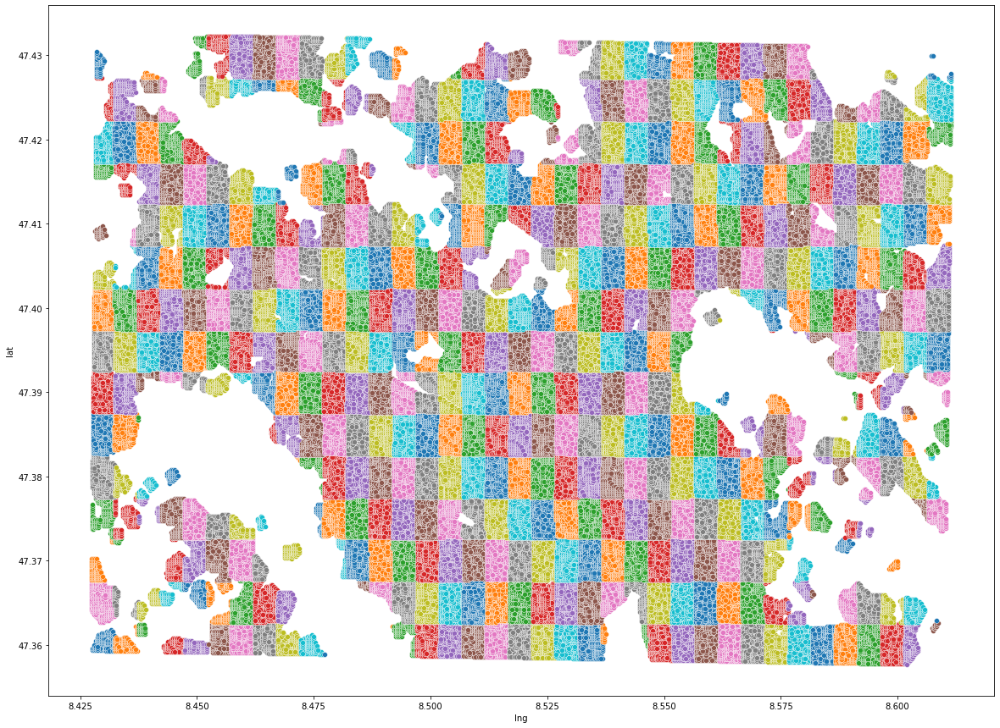

In [16]:
plt.figure(figsize=(20, 15))
for i in data_pop_sq.keys():
    ax = sns.scatterplot(data = data_pop_sq[i], x = "lng", y = "lat")

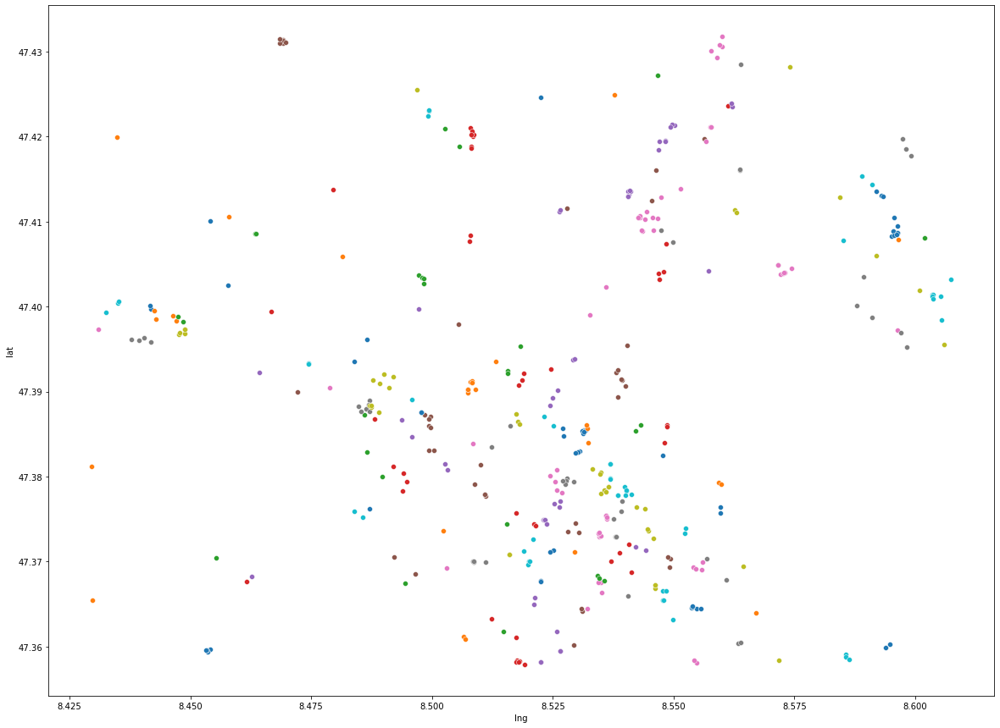

In [17]:
plt.figure(figsize=(20, 15))
for i in data_sup_sq.keys():
    ax = sns.scatterplot(data = data_sup_sq[i], x = "lng", y = "lat")

In [18]:
#get the list of squares
list_squares=[]
for key in data_pop_sq.keys():
    list_squares.append(key)
#list_squares

In [19]:
type(data_pop_sq)

dict

In [20]:
list_udl=[]
list_udl.append(list_squares)
columns=["lat","lng","hh_ha","pers_ha","pt_class","pt_dis","station_dis","noise_street"]
for col in columns:
    list_column=[]
    for key,value in data_pop_sq.items():
        df = value
        mean=df[col].mean()        
        list_column.append(mean)
        
    list_udl.append(list_column)
    
len(list_udl)

9

In [21]:
#data for calculate the mean of each squares
data_cal_pop=pd.DataFrame(list_udl).transpose()
data_cal_pop.columns=["square_id","center_lat","center_lng","hh_ha","pers_ha","pt_class","pt_dis","station_dis","noise_street"]
data_cal_pop

data_cal_pop["pt_class"] = data_cal_pop["pt_class"].replace(np.nan, 0.01)
data_cal_pop["pt_class"] = data_cal_pop["pt_class"].replace(np.nan, 0.01)

In [30]:
data_cal_pop

,square_id,center_lat,center_lng,hh_ha,pers_ha,pt_class,pt_dis,station_dis,noise_street
0,sq1-1,47.360332,8.430295,0.0,0.0,3.956522,562.030075,8531.165414,52.398496
1,sq1-2,47.360081,8.434614,1.446809,3.06383,2.893617,372.180851,8220.904255,52.712766
2,sq1-3,47.361836,8.438194,0.0,0.0,3.500000,486.25,7911.785714,66.071429
3,sq1-4,47.359902,8.44525,8.0,19.076923,3.780220,158.021978,7450.054945,55.714286
4,sq1-5,47.35977,8.449631,3.478261,8.869565,3.000000,85.869565,7136.086957,62.804348
...,...,...,...,...,...,...,...,...,...
550,sq15-33,NaN,NaN,NaN,NaN,0.010000,NaN,NaN,NaN
551,sq15-34,NaN,NaN,NaN,NaN,0.010000,NaN,NaN,NaN
552,sq15-35,47.427654,8.598256,0.0,0.0,0.010000,452.307692,3705.0,32.846154
553,sq15-36,47.4274,8.60649,0.0,0.0,0.010000,235.0,4200.0,66.0


In [31]:
perc_udl = data_cal_pop.to_csv('data_square_udl.csv')

In [22]:
#get the center position of each square

#columns=["lat","lng"]
#for col in columns:
    #list_column=[]
    #for key,value in data_sup_sq.items():
        #df = value
        #mean=df[col].mean()        
        #list_column.append(mean)
        
    #list_sup.append(list_column)
#list_sup

In [23]:
#calculate the number of supermarket in each square
list_sup=[]
list_sup.append(list_squares)
list_count=[]
for key,value in data_sup_sq.items():
        df = value
        count=df["name_supermarkt"].count()        
        list_count.append(count)
        
list_sup.append(list_count)

In [24]:
data_cal_sup=pd.DataFrame(list_sup).transpose()
data_cal_sup.columns=["square_id","number of supermarket",]

data_cal_sup["sup_per_pop"]=data_cal_sup["number of supermarket"]/ data_cal_pop["pers_ha"]


In [25]:
data_cal_sup["sup_per_pop"] = data_cal_sup["sup_per_pop"].replace(np.nan, 0.01)
data_cal_sup["sup_per_pop"] = data_cal_sup["sup_per_pop"].replace(0.0, 0.01)
data_cal_sup["number of supermarket"] = data_cal_sup["number of supermarket"].replace(0.0, 0.01)
data_cal_sup

,square_id,number of supermarket,sup_per_pop
0,sq1-1,0.01,0.01
1,sq1-2,0.01,0.01
2,sq1-3,0.01,0.01
3,sq1-4,0.01,0.01
4,sq1-5,0.01,0.01
...,...,...,...
550,sq15-33,0.01,0.01
551,sq15-34,0.01,0.01
552,sq15-35,0.01,0.01
553,sq15-36,0.01,0.01


In [33]:
data_cal_sup.describe()

,number of supermarket,sup_per_pop
count,555.000000,555.000000
mean,0.823351,0.059785
std,1.840578,0.417717
min,0.010000,0.004476
25%,0.010000,0.010000
50%,0.010000,0.010000
75%,1.000000,0.012410
max,12.000000,8.000000


In [32]:
perc_sp = data_cal_sup.to_csv('data_square_supermarket.csv')

In [26]:
import plotly.graph_objects as go
import plotly.express as px
import pandas as pd
from plotly.subplots import make_subplots

In [27]:
fig=go.Figure()
for i in data_pop_sq.keys():
    data=data_pop_sq[i]
    fig.add_trace(go.Scatter(x=data["lng"], y =data["lat"],showlegend=False,opacity=0.2))

fig.add_trace(go.Scatter(x=data_cal_pop["center_lng"],y=data_cal_pop["center_lat"],mode="markers",
                         name="Number of supermarket per population unit",marker={
                             "color":"red",
                      "size": data_cal_sup['sup_per_pop'], "sizemode": "area", 
                      "sizeref": 2*max(data_cal_sup['sup_per_pop'])/1000
                  },))

fig.show()

In [28]:
fig=go.Figure()
for i in data_pop_sq.keys():
    data=data_pop_sq[i]
    fig.add_trace(go.Scatter(x=data["lng"], y =data["lat"],showlegend=False,opacity=0.2))


fig.add_trace(go.Scatter(x=data_cal_pop["center_lng"],y=data_cal_pop["center_lat"],mode="markers",
                         name="pt_class",marker={
                             "color":"RoyalBlue",
                      "size": data_cal_pop["pt_class"], "sizemode": "area", 
                      "sizeref": 2*max(data_cal_sup['sup_per_pop'])/500
                  },))

fig.show()

In [29]:
fig=go.Figure()
for i in data_pop_sq.keys():
    data=data_pop_sq[i]
    fig.add_trace(go.Scatter(x=data["lng"], y =data["lat"],showlegend=False,opacity=0.2))


fig.add_trace(go.Scatter(x=data_cal_pop["center_lng"],y=data_cal_pop["center_lat"],mode="markers",
                         name="Number of supermarkets",marker={
                             "color":"SeaGreen",
                      "size": data_cal_sup["number of supermarket"], "sizemode": "area", 
                      "sizeref": 2*max(data_cal_sup['sup_per_pop'])/500
                  },))

fig.show()